In [1]:
!pip install tensorflow-hub

In [2]:
!pip install torch torchvision pytorch-fid

In [3]:
import kagglehub
soumikrakshit_anime_faces_path = kagglehub.dataset_download('soumikrakshit/anime-faces')

print('Data source import complete.')


100%|██████████| 441M/441M [00:06<00:00, 74.9MB/s]

Extracting files...


Data source import complete.


In [4]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm
import torchvision
from scipy.linalg import sqrtm
import tensorflow_hub as hub


import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

# load the files

In [5]:
dataset_path= soumikrakshit_anime_faces_path

In [6]:
image_paths=[]
for root, dirs, files in os.walk(dataset_path):
    for file in files:
        if file.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp')):
            image_path = os.path.join(root, file)
            image_paths.append(image_path)

In [7]:
len(image_paths)

43102

# Visualize the Image Dataset

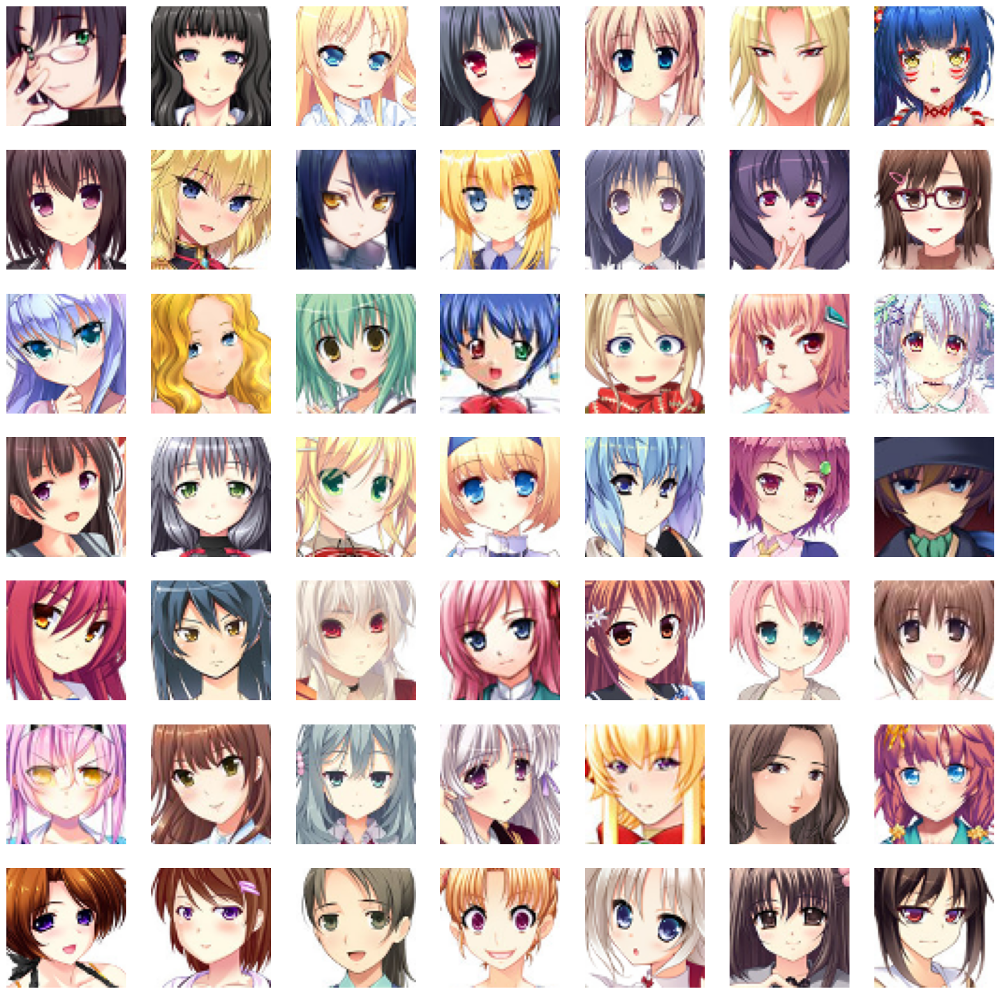

In [8]:
plt.figure(figsize=(20,20))
temp_images=image_paths[:49]
index=1

for image_path in temp_images:
    plt.subplot(7,7,index)
    img=load_img(image_path)
    img=np.array(img)
    plt.imshow(img)
    plt.axis('off')
    index=index+1

In [9]:
train_images=[np.array(load_img(path)) for path in tqdm(image_paths)]
train_images=np.array(train_images)

  0%|          | 0/43102 [00:00<?, ?it/s]

In [10]:
train_images[0].shape

(64, 64, 3)

In [11]:
train_images=train_images.reshape(train_images.shape[0],64,64,3).astype('float32')

In [12]:
train_images=(train_images-127.5)/127.5

## Create Generator & Discriminator Models

In [13]:
LATENT_DIM=100
WEIGHT_INIT=keras.initializers.RandomNormal(mean=0.0,stddev=0.02)
CHANNELS=3

### Generator Model

In [14]:
model=Sequential(name='generator')

model.add(layers.Dense(8*8*512,input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Reshape((8,8,512)))

model.add(layers.Conv2DTranspose(256, (4,4), strides=(2,2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2DTranspose(64, (4,4), strides=(2,2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4,4), padding='same', activation='tanh'))

generator=model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

### Discriminator Model

In [15]:
model=Sequential(name='discriminator')
input_shape=(64,64,3)
alpha=0.2

model.add(layers.Conv2D(64, (4,4), strides=(2,2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4,4), strides=(2,2), padding='same'))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4,4), strides=(2,2), padding='same'))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

model.add(layers.Dense(1, activation='sigmoid'))
discriminator=model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

## Create DCGAN

In [16]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [17]:
import torch
import torchvision.transforms as transforms
import numpy as np
import pytorch_fid.fid_score as fid_score
import os

class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, train_images, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        self.train_images = train_images

        os.makedirs('real_images', exist_ok=True)
        os.makedirs('generated_images', exist_ok=True)

        # Save real images
        for i in range(self.num_imgs):
            img = (self.train_images[i] * 127.5 + 127.5).astype(np.uint8)
            torchvision.utils.save_image(
                torch.from_numpy(img).permute(2, 0, 1).float() / 255.0,
                f'real_images/real_{i}.png'
            )

        # Create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # Generate images from noise
        g_img = self.model.generator(self.noise)

        # Denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img = tf.cast(g_img, tf.uint8)

        # Visualize generated images
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i + 1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        plt.show()

        # Save generated images
        for i in range(self.num_imgs):
            img = g_img[i].numpy()
            torchvision.utils.save_image(
                torch.from_numpy(img).permute(2, 0, 1).float() / 255.0,
                f'generated_images/gen_{i}.png'
            )

        # Calculate FID
        fid = fid_score.calculate_fid_given_paths(
            ['real_images', 'generated_images'],
            batch_size=50,
            device='cuda' if torch.cuda.is_available() else 'cpu',
            dims=2048
        )
        print(f"Epoch {epoch}: FID: {fid}")

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')


In [18]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [19]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - d_loss: 1.0037 - g_loss: 2.1436

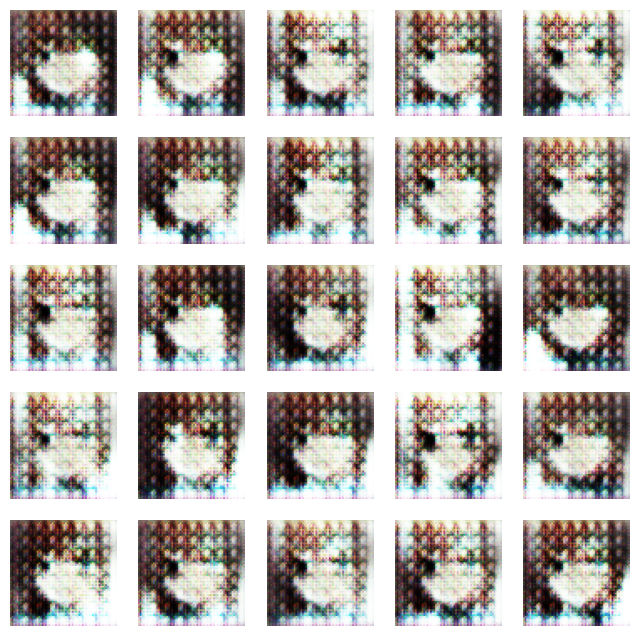

Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:01<00:00, 90.6MB/s]


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


100%|██████████| 1/1 [00:00<00:00,  3.33it/s]


Epoch 0: FID: 398.5708709528346
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 128s 83ms/step - d_loss: 1.0034 - g_loss: 2.1438
Epoch 2/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5802 - g_loss: 1.7722

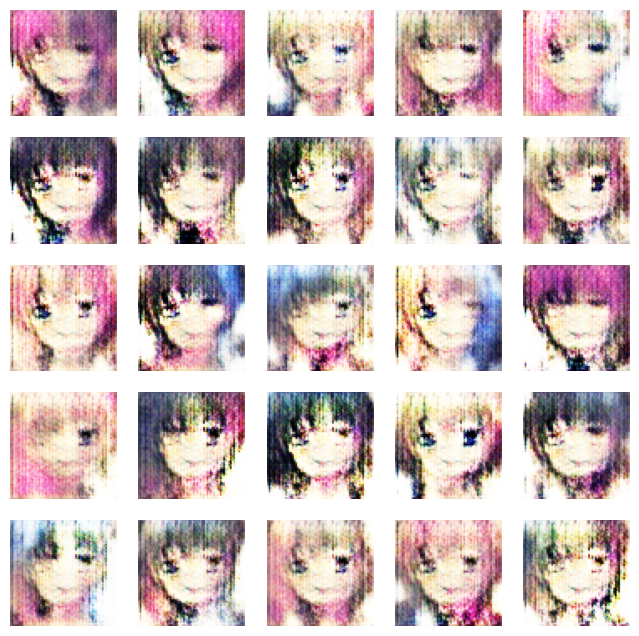

100%|██████████| 1/1 [00:00<00:00,  3.24it/s]


100%|██████████| 1/1 [00:00<00:00,  3.41it/s]


Epoch 1: FID: 389.52056931167124
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 119s 75ms/step - d_loss: 0.5802 - g_loss: 1.7722
Epoch 3/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.5984 - g_loss: 1.6131

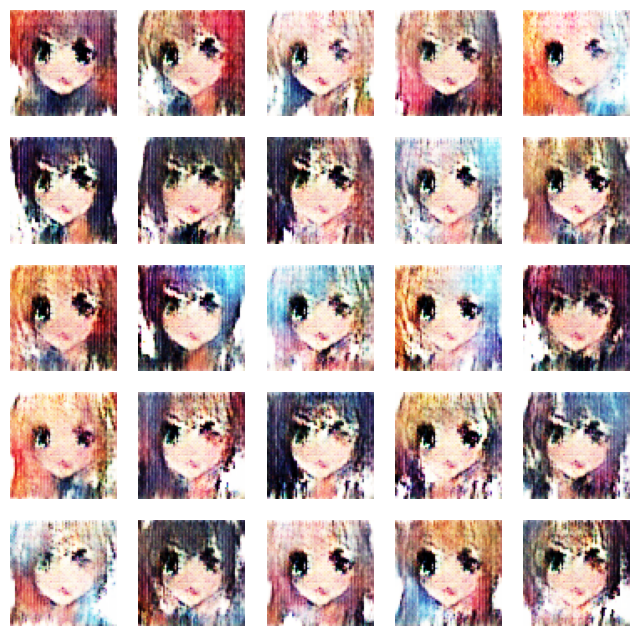

100%|██████████| 1/1 [00:00<00:00,  3.42it/s]


100%|██████████| 1/1 [00:00<00:00,  3.40it/s]


Epoch 2: FID: 449.1487571491618
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 142s 75ms/step - d_loss: 0.5984 - g_loss: 1.6131
Epoch 4/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.5796 - g_loss: 1.6546

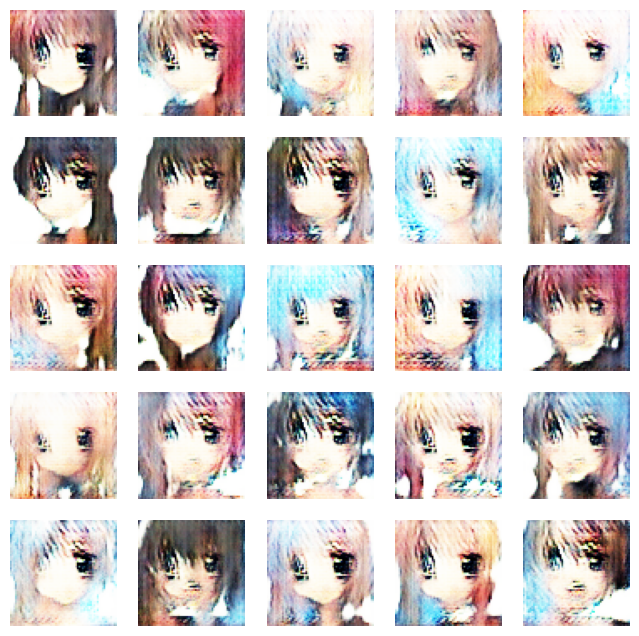

100%|██████████| 1/1 [00:00<00:00,  3.41it/s]


100%|██████████| 1/1 [00:00<00:00,  3.24it/s]


Epoch 3: FID: 347.57452088374254
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 101s 75ms/step - d_loss: 0.5796 - g_loss: 1.6547
Epoch 5/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5368 - g_loss: 1.7216

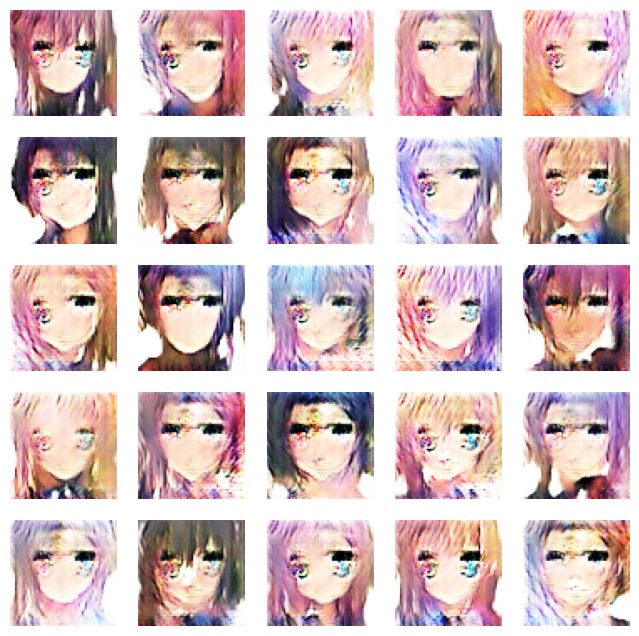

100%|██████████| 1/1 [00:00<00:00,  3.18it/s]


100%|██████████| 1/1 [00:00<00:00,  3.04it/s]


Epoch 4: FID: 256.3032176029968
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 101s 75ms/step - d_loss: 0.5368 - g_loss: 1.7216
Epoch 6/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5443 - g_loss: 1.6153

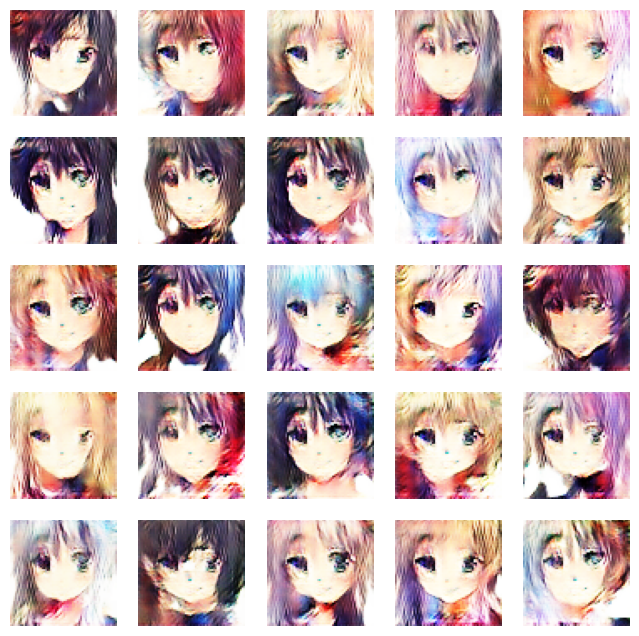

100%|██████████| 1/1 [00:00<00:00,  2.70it/s]


100%|██████████| 1/1 [00:00<00:00,  2.82it/s]


Epoch 5: FID: 240.3906981819284
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 143s 76ms/step - d_loss: 0.5444 - g_loss: 1.6152
Epoch 7/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5638 - g_loss: 1.4994

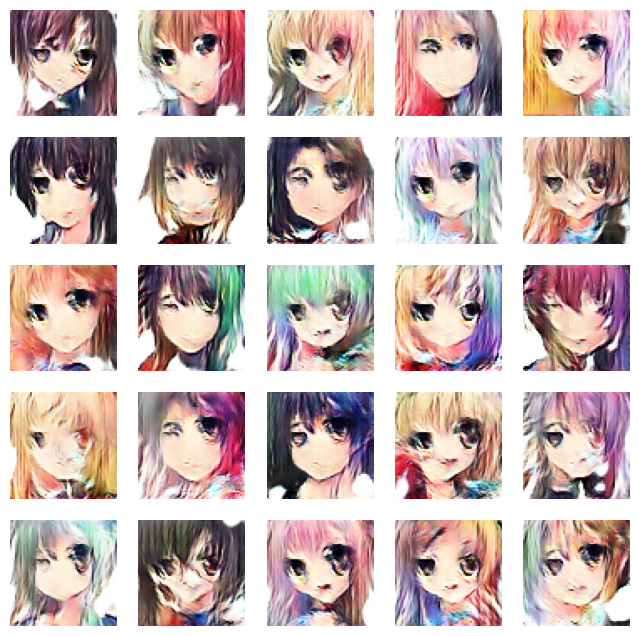

100%|██████████| 1/1 [00:00<00:00,  2.28it/s]


100%|██████████| 1/1 [00:00<00:00,  2.53it/s]


Epoch 6: FID: 240.40837044012846
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 114s 84ms/step - d_loss: 0.5638 - g_loss: 1.4993
Epoch 8/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - d_loss: 0.5749 - g_loss: 1.3483

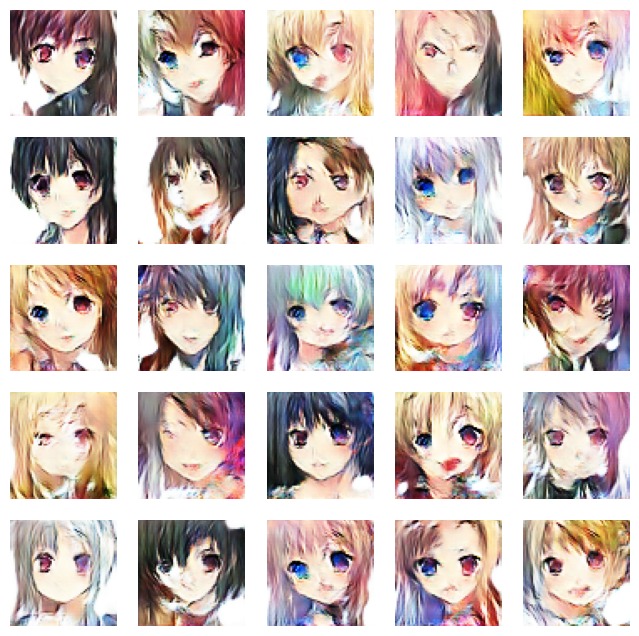

100%|██████████| 1/1 [00:00<00:00,  2.43it/s]


100%|██████████| 1/1 [00:00<00:00,  2.59it/s]


Epoch 7: FID: 217.70193011603854
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 157s 95ms/step - d_loss: 0.5749 - g_loss: 1.3482
Epoch 9/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - d_loss: 0.5989 - g_loss: 1.2350

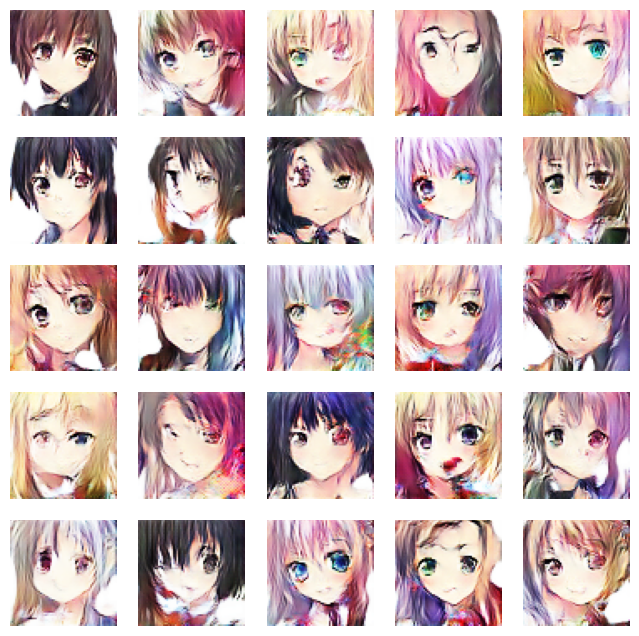

100%|██████████| 1/1 [00:00<00:00,  2.75it/s]


100%|██████████| 1/1 [00:00<00:00,  2.99it/s]


Epoch 8: FID: 200.63720806553988
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 148s 100ms/step - d_loss: 0.5989 - g_loss: 1.2350
Epoch 10/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6101 - g_loss: 1.1664

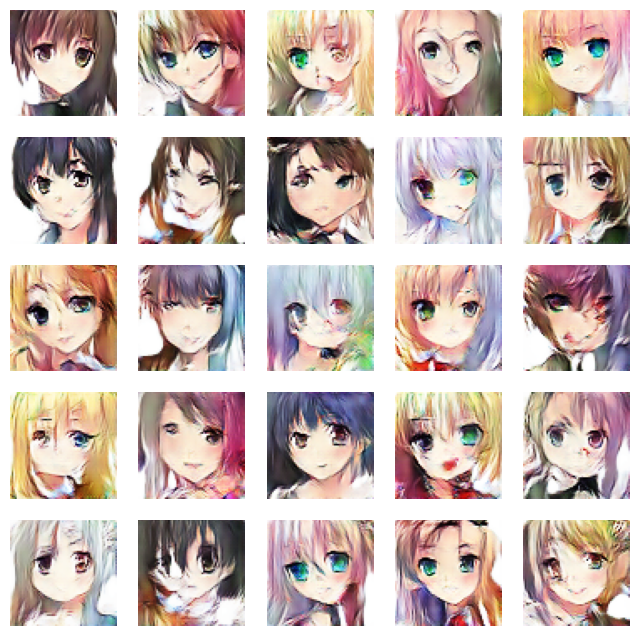

100%|██████████| 1/1 [00:00<00:00,  2.64it/s]


100%|██████████| 1/1 [00:00<00:00,  2.65it/s]


Epoch 9: FID: 184.4152395750361
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 147s 103ms/step - d_loss: 0.6101 - g_loss: 1.1664
Epoch 11/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6274 - g_loss: 1.1159

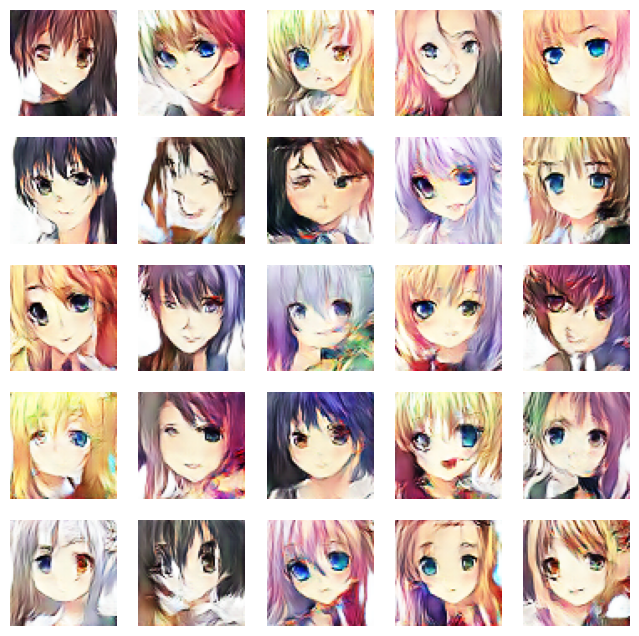

100%|██████████| 1/1 [00:00<00:00,  2.39it/s]


100%|██████████| 1/1 [00:00<00:00,  2.35it/s]


Epoch 10: FID: 179.32865779905143
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 138s 100ms/step - d_loss: 0.6274 - g_loss: 1.1159
Epoch 12/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6259 - g_loss: 1.0926

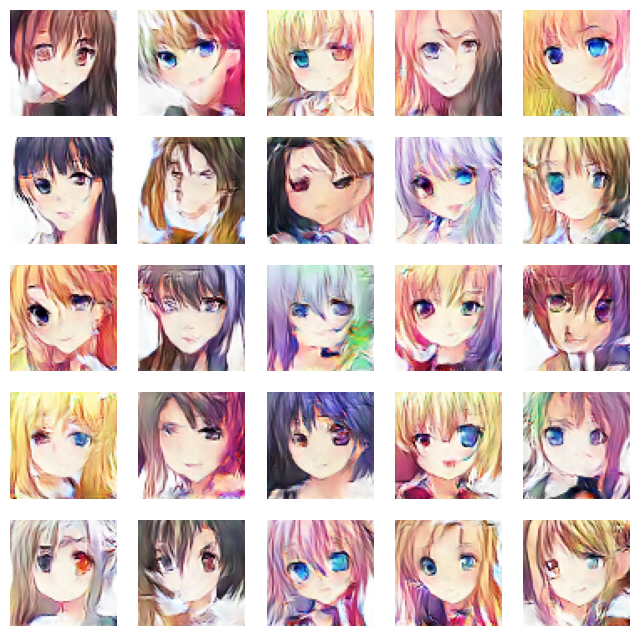

100%|██████████| 1/1 [00:00<00:00,  2.40it/s]


100%|██████████| 1/1 [00:00<00:00,  2.60it/s]


Epoch 11: FID: 182.4597693021779
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 148s 105ms/step - d_loss: 0.6259 - g_loss: 1.0926
Epoch 13/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6248 - g_loss: 1.0941

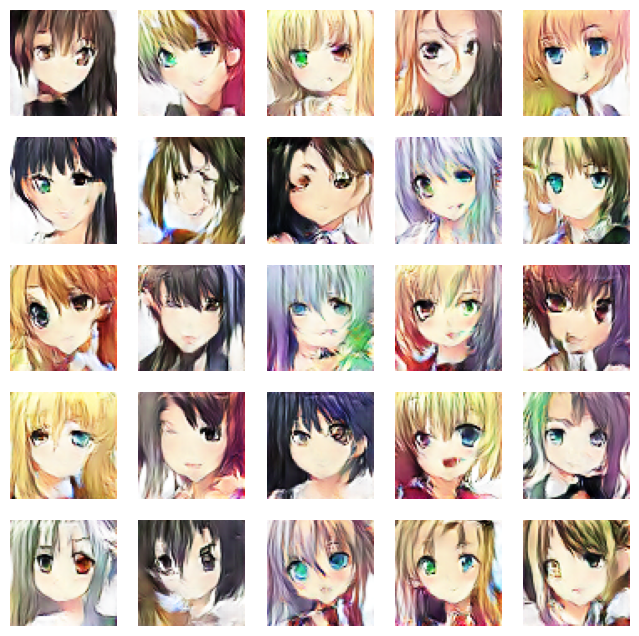

100%|██████████| 1/1 [00:00<00:00,  2.77it/s]


100%|██████████| 1/1 [00:00<00:00,  2.74it/s]


Epoch 12: FID: 164.2172485438199
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 143s 106ms/step - d_loss: 0.6248 - g_loss: 1.0941
Epoch 14/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.6180 - g_loss: 1.0854

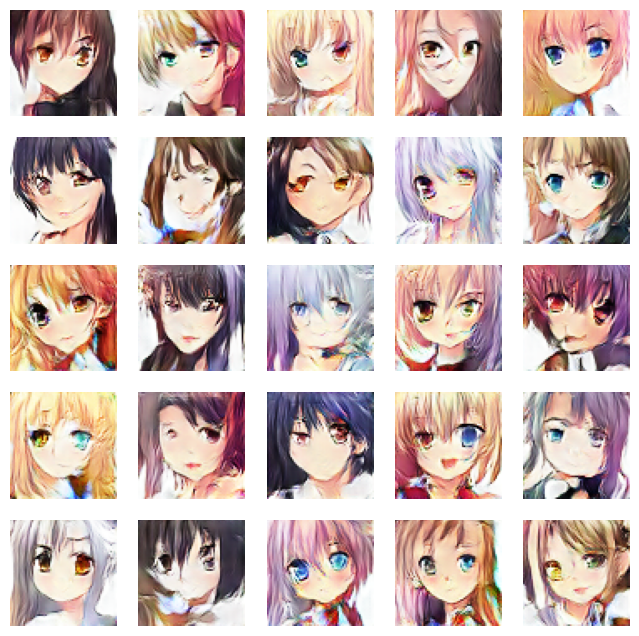

100%|██████████| 1/1 [00:00<00:00,  2.69it/s]


100%|██████████| 1/1 [00:00<00:00,  2.66it/s]


Epoch 13: FID: 169.31322044093312
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 188s 95ms/step - d_loss: 0.6180 - g_loss: 1.0854
Epoch 15/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6114 - g_loss: 1.0991

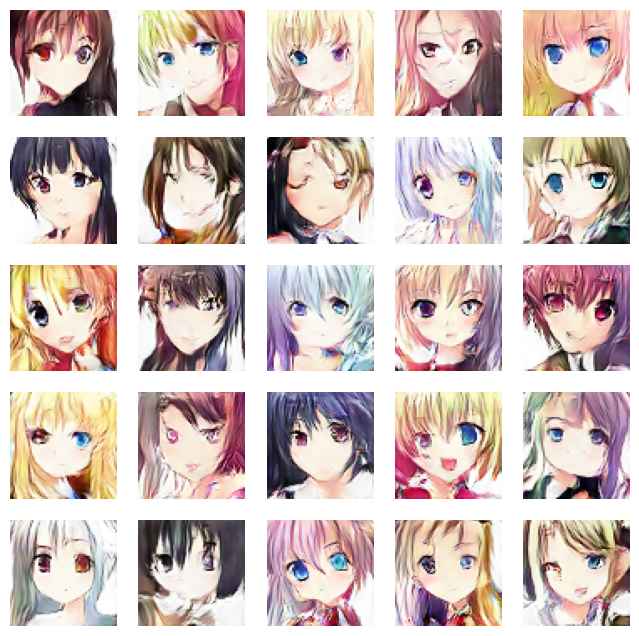

100%|██████████| 1/1 [00:00<00:00,  2.61it/s]


100%|██████████| 1/1 [00:00<00:00,  3.03it/s]


Epoch 14: FID: 166.33486884785714
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 140s 104ms/step - d_loss: 0.6114 - g_loss: 1.0991
Epoch 16/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.6029 - g_loss: 1.1181

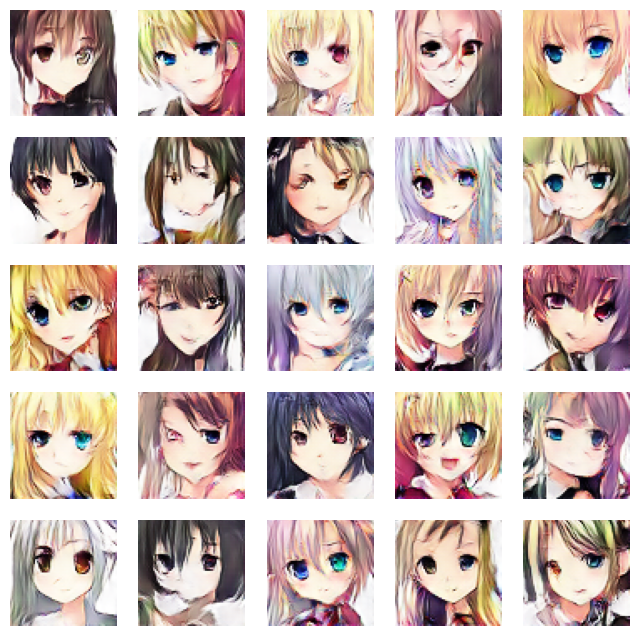

100%|██████████| 1/1 [00:00<00:00,  2.70it/s]


100%|██████████| 1/1 [00:00<00:00,  2.67it/s]


Epoch 15: FID: 162.64335573230937
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 143s 105ms/step - d_loss: 0.6029 - g_loss: 1.1181
Epoch 17/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5958 - g_loss: 1.1381

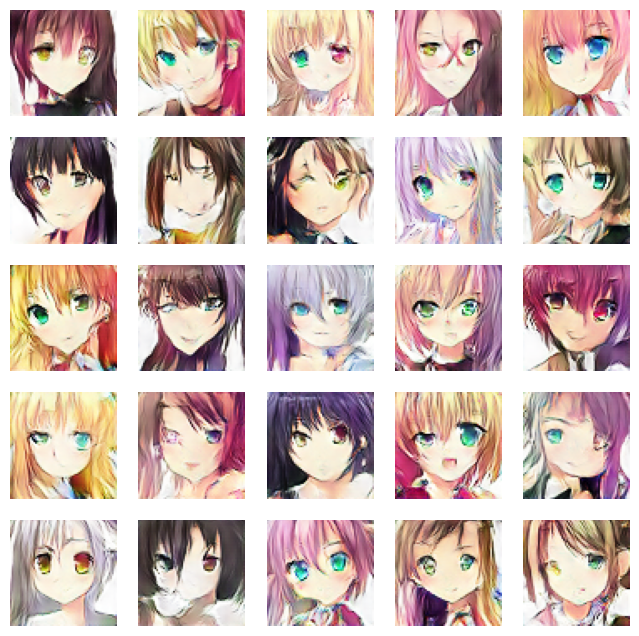

100%|██████████| 1/1 [00:00<00:00,  2.26it/s]


100%|██████████| 1/1 [00:00<00:00,  2.93it/s]


Epoch 16: FID: 146.32882092698205
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 144s 107ms/step - d_loss: 0.5958 - g_loss: 1.1381
Epoch 18/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5826 - g_loss: 1.1624

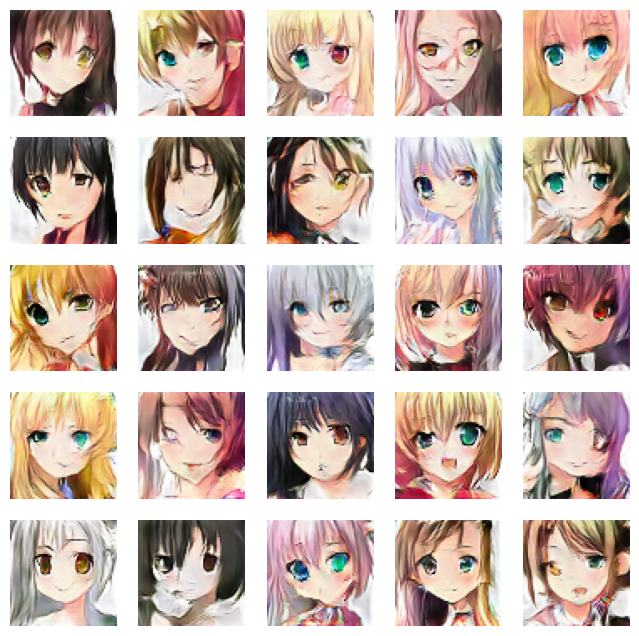

100%|██████████| 1/1 [00:00<00:00,  2.55it/s]


100%|██████████| 1/1 [00:00<00:00,  2.73it/s]


Epoch 17: FID: 157.67177468447164
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 224s 123ms/step - d_loss: 0.5826 - g_loss: 1.1624
Epoch 19/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5771 - g_loss: 1.1811

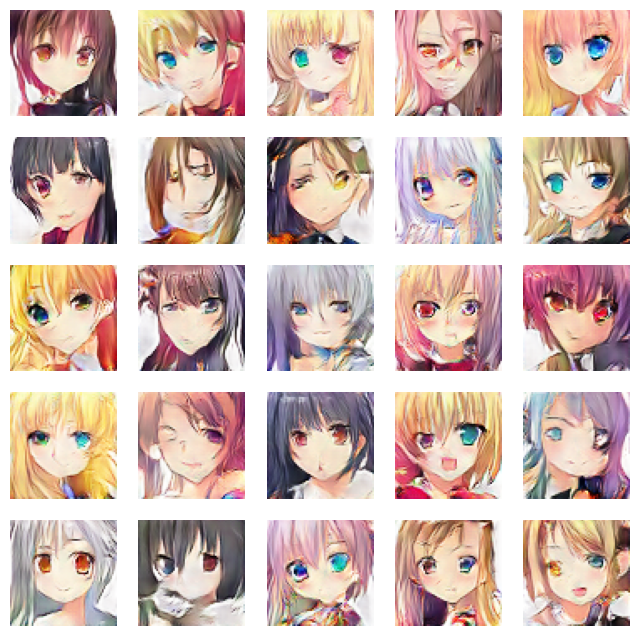

100%|██████████| 1/1 [00:00<00:00,  2.50it/s]


100%|██████████| 1/1 [00:00<00:00,  2.54it/s]


Epoch 18: FID: 155.48761557175393
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 176s 104ms/step - d_loss: 0.5771 - g_loss: 1.1811
Epoch 20/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5738 - g_loss: 1.2009

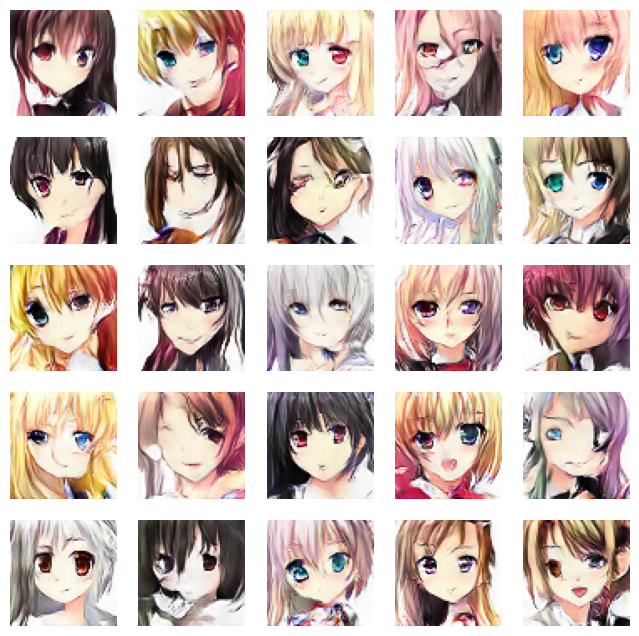

100%|██████████| 1/1 [00:00<00:00,  2.04it/s]


100%|██████████| 1/1 [00:00<00:00,  2.47it/s]


Epoch 19: FID: 163.28663030117525
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 157s 115ms/step - d_loss: 0.5738 - g_loss: 1.2009
Epoch 21/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - d_loss: 0.5681 - g_loss: 1.2302

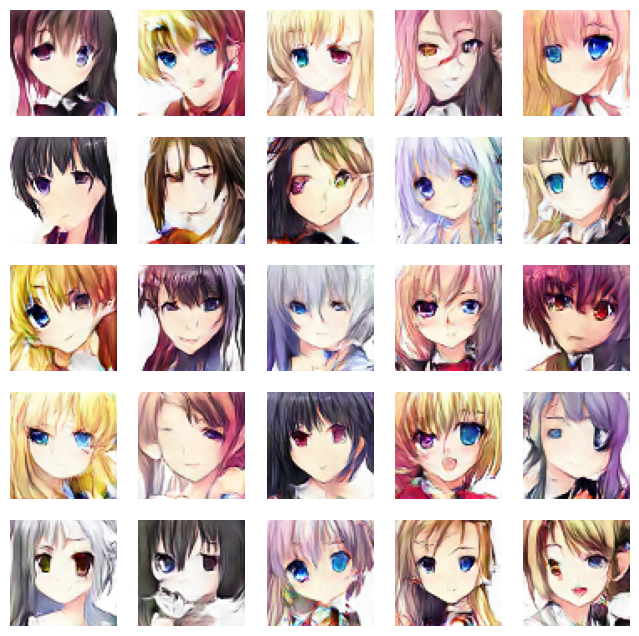

100%|██████████| 1/1 [00:00<00:00,  2.46it/s]


100%|██████████| 1/1 [00:00<00:00,  2.89it/s]


Epoch 20: FID: 152.54953497303038
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 201s 115ms/step - d_loss: 0.5681 - g_loss: 1.2302
Epoch 22/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5607 - g_loss: 1.2355

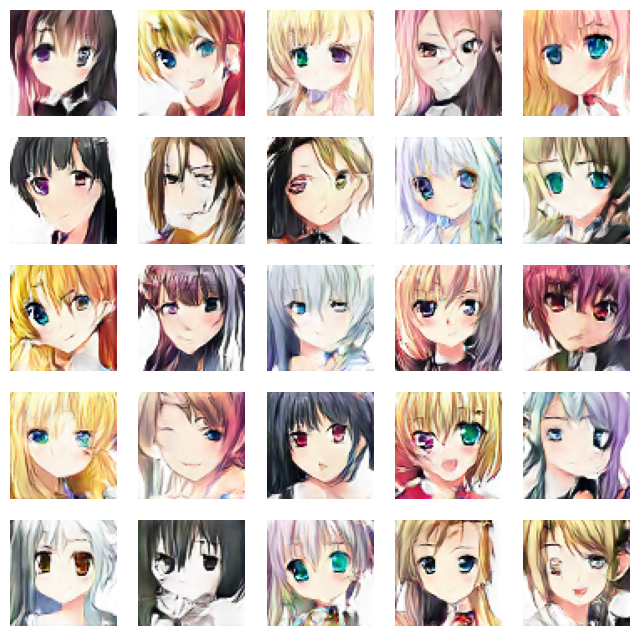

100%|██████████| 1/1 [00:00<00:00,  2.27it/s]


100%|██████████| 1/1 [00:00<00:00,  2.23it/s]


Epoch 21: FID: 148.20993098959696
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 192s 107ms/step - d_loss: 0.5607 - g_loss: 1.2355
Epoch 23/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.5539 - g_loss: 1.2755

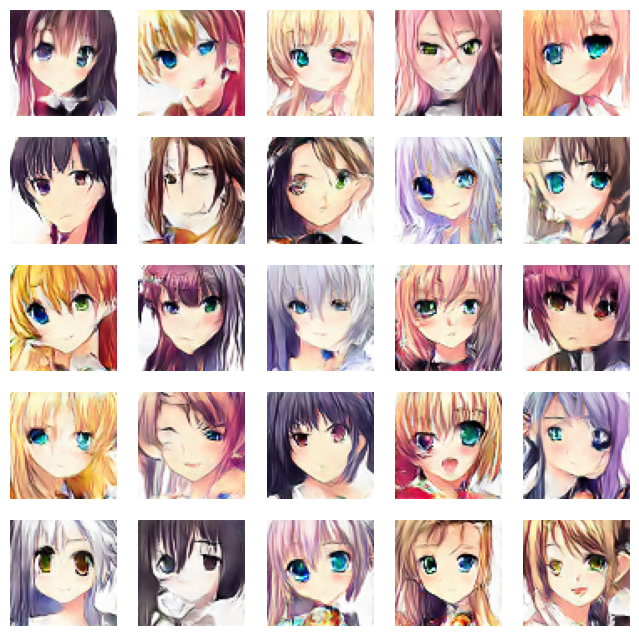

100%|██████████| 1/1 [00:00<00:00,  2.32it/s]


100%|██████████| 1/1 [00:00<00:00,  2.20it/s]


Epoch 22: FID: 141.30245993542124
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 200s 106ms/step - d_loss: 0.5539 - g_loss: 1.2755
Epoch 24/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.5456 - g_loss: 1.2935

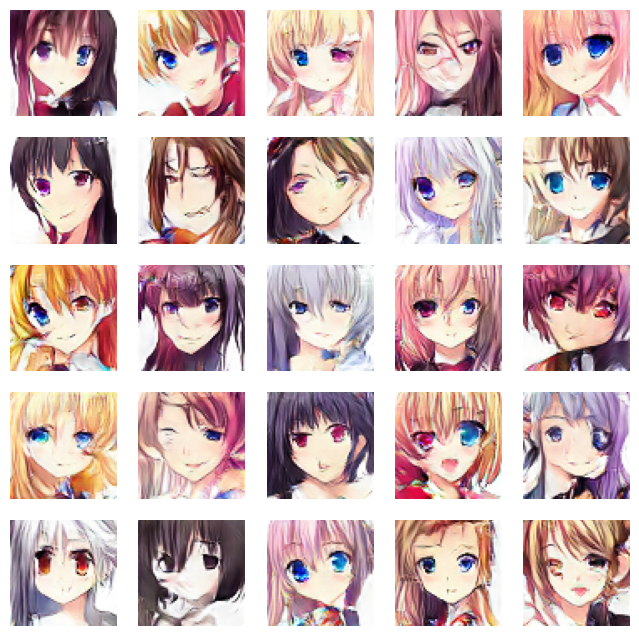

100%|██████████| 1/1 [00:00<00:00,  2.52it/s]


100%|██████████| 1/1 [00:00<00:00,  3.01it/s]


Epoch 23: FID: 144.57893594412576
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 210s 112ms/step - d_loss: 0.5456 - g_loss: 1.2935
Epoch 25/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.5355 - g_loss: 1.3145

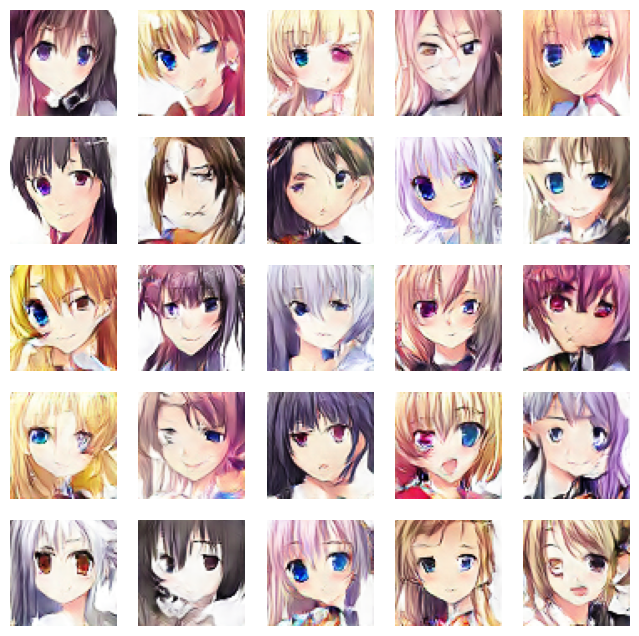

100%|██████████| 1/1 [00:00<00:00,  2.47it/s]


100%|██████████| 1/1 [00:00<00:00,  2.66it/s]


Epoch 24: FID: 157.07678474584486
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 155s 115ms/step - d_loss: 0.5355 - g_loss: 1.3145
Epoch 26/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - d_loss: 0.5337 - g_loss: 1.3400

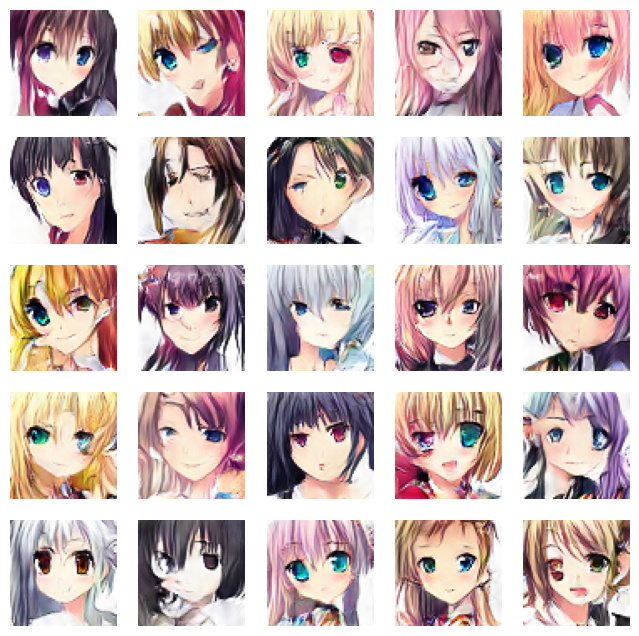

100%|██████████| 1/1 [00:00<00:00,  2.14it/s]


100%|██████████| 1/1 [00:00<00:00,  2.18it/s]


Epoch 25: FID: 146.45695888842943
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 200s 114ms/step - d_loss: 0.5337 - g_loss: 1.3400
Epoch 27/50
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - d_loss: 0.5294 - g_loss: 1.3757

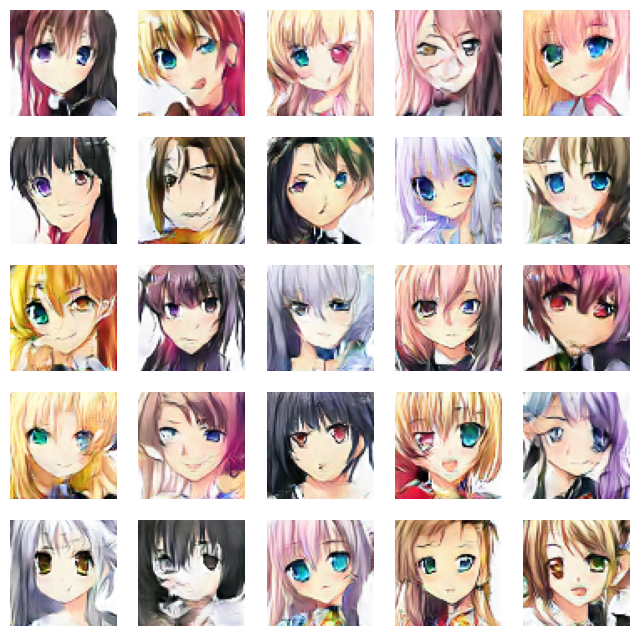

100%|██████████| 1/1 [00:00<00:00,  2.71it/s]


100%|██████████| 1/1 [00:00<00:00,  2.92it/s]


Epoch 26: FID: 137.4722333546361
1347/1347 ━━━━━━━━━━━━━━━━━━━━ 188s 103ms/step - d_loss: 0.5294 - g_loss: 1.3757
Epoch 28/50
1254/1347 ━━━━━━━━━━━━━━━━━━━━ 5s 63ms/step - d_loss: 0.5203 - g_loss: 1.4053

In [ ]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor(train_images = train_images)])